In [1]:
%load_ext autoreload
%autoreload 2

import os 
import shutil
import numpy as n
from datetime import date
from matplotlib import pyplot as plt
import time
import napari

In [2]:
os.chdir('/home/ali/packages/s2p-lbm/')

from suite3d.job import Job
from suite3d import lbmio, utils, ui
from suite3d import tiff_utils as tfu
from suite3d import file_utils as flu

In [3]:
subjects_dir =   '/mnt/zortex-subjects/'
expt_info = { 
    'subject':         'SS004',
    'date' :          '2024-08-12',
    'expnum' :         [1,2,3,4,5,7, 8, 9, 10, 11],}

tifs, si_params, exp_str = flu.find_exp(subjects_dir, **expt_info, verbose=False)

job_params = {    
    # number of channels recorded in the tiff file, typically 30
    'n_ch_tif' : 26,
    # number of planes in the deeper cavity, typically 15
    'cavity_size' : 13,
    # convert from the Scanimage channel ordering to deep-to-shallow ordering
    # in our case, ScanImage channel numbers are in temporal order. 
    'planes' : n.array([ 0,  2,  4,  6,  8, 10, 12, 14,
                        16, 18, 20, 22, 24, 1,  3, 5,  7,9,11, 13, 15,17,19,21]),
    # number of files to use for the initial pass
    'n_init_files' :   4,
    
    # number of pixels to fuse between the ROI strips
    # the auto-detection doesn't always work well, recommend 
    # manually tuning it to reduce the stitching artifacts
    'fuse_shift_override' : 6,
    
    # will try to automatically estimate crosstalk using 
    # the shallowest crosstalk_n_planes planes. if you want to override,
    # set override_crosstalk = float between 0 and 1
    'subtract_crosstalk' : True,
    
    # volume rate in acquisition
    'fs' : flu.get_si_params(tifs[0])['vol_rate'],
    
    # 3D GPU registration - fast! 
    # for now, 3D + GPU are well-tested, other options might have minor bugs
    # if you run into them, let us know! we'll fix them
    '3d_reg' : False,
    'use_GPU_registration' : True,
}

In [4]:

job_params['fs'] = si_params['vol_rate']

savedir = os.path.join('/mnt/md0/runs', expt_info['subject'], expt_info['date'])
os.makedirs(savedir, exist_ok=True)

In [5]:
# Create the job
job = Job('/mnt/md0/runs',exp_str, tifs = tifs,
          params=job_params, create=False, overwrite=True, verbosity = 3)

   Found and loaded params from /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/params.npy


In [6]:
job.export_results('/mnt/zeytin-f1/s3d-results/',result_dir_name='rois')

   Created dir /mnt/zeytin-f1/s3d-results/s3d-results-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11 to export results
      Loading from /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois/stats_small.npy
      Loading from /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois/info.npy
      Loading from /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois/F.npy
      Loading from /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois/spks.npy
      Loading from /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois/Fneu.npy
      Loading from /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois/iscell.npy
   /mnt/zortex-subjects/SS004/2024-08-12/1/2024-08-12_1_SS004_2P_00001_00001.tif is 100 frames and 3971882546 bytes
   /mnt/zortex-subjects/SS004/2024-08-12/1/2024-08-12_1_SS004_2P_00001_00028.tif is 45 frames and 1787368786 bytes
   /mnt/zortex-subjects/SS004/2024-08-12/2/2024-08-12_2_SS004_2P_00001_00024.tif is 75 frames and 2978921746 byt

In [ ]:
# optional parameters for initialization
# load 1 file to initialize, and select 200 frames randomly to do initalization on
job.params['n_init_files'] = 4
job.params['init_n_frames'] = None
job.params['init_file_sample_method'] = 'even'
job.params['voxel_size_um'] = (20, 3.0, 3.0)

In [ ]:
%%time
summary = job.run_init_pass()

In [ ]:
summary = job.load_summary()

In [ ]:
tfu.show_tif(summary['ref_img_3d'][0])

In [ ]:
# split the large tiffs into files of size 100 after registration
job.params['split_tif_size'] = 100

In [ ]:
%%time
job.register_gpu_3d(tifs = job.tifs[:150])

In [ ]:
mov_full = job.get_registered_movie('registered_fused_data', 'fused')
im_full = mov_full[:,:200].mean(axis=1).compute()

In [ ]:
tfu.show_tif(im_full[0])

In [ ]:

job.params['voxel_size_um'] = (20, 3.0, 3.0)
job.params['sdnorm_exp'] = 0.85
job.params['npil_filt_xy_um'] = 70
params_to_sweep = {
    'cell_filt_type' : ('gaussian','unif'),
    'cell_filt_xy_um' : (5,10,15,20),
    # 'npil_filt_xy_um' : (40, 70, 100),
    # 'sdnorm_exp' : (0.8,1.0),
}
job.sweep_corrmap(params_to_sweep, iter_limit=2, sweep_name='corrmap2')

In [ ]:
%%time
job.params['voxel_size_um'] = (20, 3.0, 3.0)
job.params['sdnorm_exp'] = 0.85
job.params['npil_filt_xy_um'] = 70
job.params['cell_filt_type'] = 'gaussian'
job.params['cell_filt_xy_um'] = 5
corr_map = job.calculate_corr_map()

In [47]:
res = job.load_corr_map_results()
vmap = res['vmap']

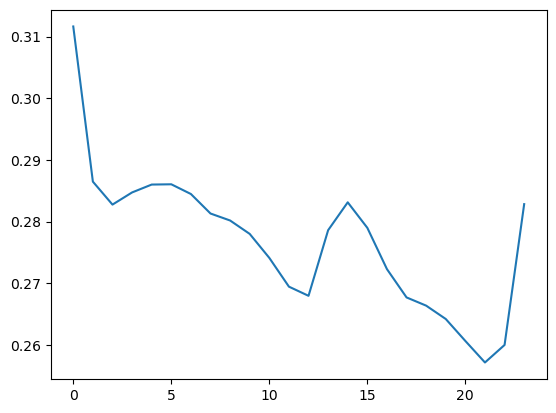

In [48]:
plt.plot(vmap.mean(axis=(1,2)))

In [56]:
# most important parameter - any value of the corrmap
# above this will be considered a peak for a possible ROI,
# and will be used as a "seed" to grow an ROI around it
# bigger number: fewer ROIs, only bright ones
# smaller number: many ROIs, increasingly worse quality
job.params['peak_thresh'] = 0.33
# optionally, bin the movie in time to speed up detection
# probably a good idea if you have high framerate (>5 Hz?)
job.params['detection_timebin'] = 1 

# when extending an ROI, compare its activity to its neighboring pixels
# in frames where the fluorescence is above this percentile
job.params['percentile'] = 99.0

job.params['extend_thresh'] = 0.2
job.params['activity_thresh'] = 7.0
sweep_params = {
    'percentile' : (95.0, 99.0, 99.9),
    'activity_thresh' : (7.0, 15.0),
    'extend_thresh' : (0.05, 0.1, 0.2),
}

job.sweep_segmentation(sweep_params, vmap=vmap,patches_to_segment=[20,40], ts=(0,4000), all_combinations=True)

   Setting up sweep
      Found dir /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/sweeps/seg
      Updating self.dirs tag sweeps-seg
   Total of 18 combinations
      Created directory for comb_00000 with params comb00000-params-percentile_95.000-activity_thresh_7.000-extend_thresh_0.050
      Found dir /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/sweeps/seg/comb_00000
      Updating self.dirs tag sweeps-seg-comb_00000
      Created directory for comb_00001 with params comb00001-params-percentile_95.000-activity_thresh_7.000-extend_thresh_0.100
      Found dir /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/sweeps/seg/comb_00001
      Updating self.dirs tag sweeps-seg-comb_00001
      Created directory for comb_00002 with params comb00002-params-percentile_95.000-activity_thresh_7.000-extend_thresh_0.200
      Found dir /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/sweeps/seg/comb_00002
      Updating self.dirs tag sweeps-seg-comb_00002
      

{'sweep_dir_path': '/mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/sweeps/seg',
 'sweep_dir_name': 'sweeps-seg',
 'init_params': {'fs': 4.481564245810056,
  'tau': 1.3,
  'voxel_size_um': (20, 3.0, 3.0),
  'planes': array([ 0,  2,  4,  6,  8, 10, 12, 14, 16, 18, 20, 22, 24,  1,  3,  5,  7,
          9, 11, 13, 15, 17, 19, 21]),
  'convert_plane_ids_to_channel_ids': False,
  'n_ch_tif': 26,
  'notch_filt': None,
  'fix_fastZ': False,
  'n_init_files': 4,
  'init_file_pool': None,
  'init_file_sample_method': 'even',
  'init_n_frames': None,
  'enforce_positivity': True,
  'fix_shallow_plane_shift_estimates': True,
  'fix_shallow_plane_shift_esimate_threshold': 20,
  'overwrite_plane_shifts': None,
  'subtract_crosstalk': True,
  'override_crosstalk': None,
  'crosstalk_percentile': 99.5,
  'crosstalk_sigma': 0.01,
  'cavity_size': 13,
  'crosstalk_n_planes': 2,
  'use_GPU_registration': True,
  'fuse_strips': True,
  'fuse_shift_override': 6,
  'max_rigid_shift_pix': 100,
  'p

In [ ]:
job.params['peak_thresh'] = 0.33
# optionally, bin the movie in time to speed up detection
# probably a good idea if you have high framerate (>5 Hz?)
job.params['detection_timebin'] = 1 

# when extending an ROI, compare its activity to its neighboring pixels
# in frames where the fluorescence is above this percentile
job.params['percentile'] = 95.0

job.params['extend_thresh'] = 0.1
job.params['activity_thresh'] = 7.0
job.segment_rois(vmap=vmap)

      Found dir /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/segmentation
      Updating self.dirs tag segmentation
   Saved a copy of params at /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/segmentation
   Updated main params file
      Found dir /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois
      Updating self.dirs tag rois
   Saving results to /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/segmentation and /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois 
dict_keys(['max_img', 'mean_img', 'vmap', 'all_params'])
   Detecting from patch 1 / 88
   Created dir /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/segmentation/patch-0000 with tag segmentation-patch-0000
         Loading 19.18 GB movie to memory, shape: (14895, 24, 120, 120) 
         Loaded
         Loading movie patch to shared memory
         Loaded
      Starting extraction with peak_thresh: 0.330 and Th2: 7.000
         Iter 0000: running 16 ROIs in par

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



         Loaded
         Loading movie patch to shared memory
         Loaded
      Starting extraction with peak_thresh: 0.330 and Th2: 7.000
         Iter 0000: running 16 ROIs in parallel
         Added cell 1 at 14, 582, 641, peak: 0.625, thresh: 7.000, 979 frames, 47 pixels
         Added cell 2 at 13, 610, 647, peak: 0.595, thresh: 6.489, 1038 frames, 63 pixels
         Added cell 3 at 13, 592, 645, peak: 0.581, thresh: 6.299, 939 frames, 51 pixels
         Added cell 4 at 15, 576, 640, peak: 0.556, thresh: 6.405, 936 frames, 59 pixels
         Added cell 5 at 14, 583, 662, peak: 0.542, thresh: 5.627, 835 frames, 58 pixels
         Added cell 6 at 14, 637, 648, peak: 0.541, thresh: 5.742, 825 frames, 79 pixels
         Added cell 7 at 13, 567, 676, peak: 0.496, thresh: 5.288, 867 frames, 59 pixels
         Added cell 8 at 14, 598, 660, peak: 0.492, thresh: 5.160, 864 frames, 59 pixels
         Added cell 9 at 15, 613, 650, peak: 0.482, thresh: 6.148, 903 frames, 30 pixels
       

In [ ]:
# rois_dir_path = job.combine_patches(n.arange(80), job.dirs['rois'], deduplicate=False,
#                                     parent_dir_name='segmentation', info_use_idx=None)

In [58]:
job.compute_npil_masks(stats_dir = job.dirs['rois'])


'/mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois'

In [60]:

traces = job.extract_and_deconvolve(stats_dir=job.dirs['rois'])

   Updated main params file
   Movie shape: (24, 14895, 1036, 745)
98440
   Extracting 98440 valid cells, and saving cell flags to /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois/iscell_extracted.npy
   Extracting activity
Will extract in 30 batches of 500
Saving intermediate results to /mnt/md0/runs/s3d-SS004_2024-08-12_1-2-3-4-5-7-8-9-10-11/rois
Extracting batch 0000 of 0030
Batch size: 34 GB
Extracting batch 0001 of 0030
Batch size: 34 GB
Extracting batch 0002 of 0030
Batch size: 34 GB
Extracting batch 0003 of 0030
Batch size: 34 GB
Extracting batch 0004 of 0030
Batch size: 34 GB
Extracting batch 0006 of 0030
Batch size: 34 GB
Extracting batch 0007 of 0030
Batch size: 34 GB
Extracting batch 0008 of 0030
Batch size: 34 GB
Extracting batch 0009 of 0030
Batch size: 34 GB
Extracting batch 0010 of 0030
Batch size: 34 GB
Extracting batch 0011 of 0030
Batch size: 34 GB
Extracting batch 0012 of 0030
Batch size: 34 GB
Extracting batch 0013 of 0030
Batch size: 34 GB
Extracting b

In [ ]:
job.export_results('/mnt/zeytin-f1/s3d-results/',result_dir_name='rois')